In [1]:
%load_ext autoreload
%autoreload 2

# Initial setup

In [ ]:
import os
os.chdir('/content')
CODE_DIR = 'StyleID'

!git clone https://github.com/minha12/StyleID.git
!wget https://github.com/ninja-build/ninja/releases/download/v1.8.2/ninja-linux.zip
!sudo unzip ninja-linux.zip -d /usr/local/bin/
!sudo update-alternatives --install /usr/bin/ninja ninja /usr/local/bin/ninja 1 --force 

os.chdir(f'./{CODE_DIR}')

# Downloading models and data

We are going to download:

- Pretrained StyleGAN2 model trained on FFHQ dataset
- Latent codes of faces in CelebA-HQ dataset
- Identity disentanglement rank for single channels
- Identity disentanglement rank for group of 256 channels

In [ ]:
!pip install --upgrade --no-cache-dir gdown

In [2]:
!python utils/download_files.py

Downloading...
From: https://drive.google.com/uc?id=1EM87UquaoQmk17Q8d5kYIAHqu0dkYqdT
To: /media/src/workspace/StyleID/pretrained_models/stylegan2-ffhq-config-f.pt
100%|████████████████████████████████████████| 381M/381M [00:31<00:00, 11.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1VlkFMkDaT25V00rk1tuovtkqd2h6Ggqo
To: /media/src/workspace/StyleID/data/celeba_samples.pt
100%|██████████████████████████████████████| 36.9M/36.9M [00:03<00:00, 12.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=12UlGf6xVbteJtzo8JzysuhPmujkzACiw
To: /media/src/workspace/StyleID/statistics/channels_rank.npy
100%|██████████████████████████████████████| 32.9k/32.9k [00:00<00:00, 5.03MB/s]
Downloading...
From: https://drive.google.com/uc?id=12UlGf6xVbteJtzo8JzysuhPmujkzACiw
To: /media/src/workspace/StyleID/statistics/group_256_rank.npy
100%|██████████████████████████████████████| 32.9k/32.9k [00:00<00:00, 4.76MB/s]
Downloading...
From: https://drive.google.com/uc?id=1juhw71f7YQbApYYpOQI_

In [2]:
from styleid import StyleID
import styleid as generator
import torch
import pickle
import numpy as np
import random
import matplotlib.pyplot as plt
from utils.common import tensor2im
from utils.common import image_grid, top_n, swap_by_index

# plt.rcParams['figure.dpi'] = 200

facegen = StyleID()

### Loading the sampled latent codes

Note that we can directly project the images into StyleGAN2's latent space. For the sake of simplicity, we use the projected latent code.

In [3]:
dataset = torch.load('./data/celeba_samples.pt')
dataset.shape

torch.Size([1000, 18, 512])

Visualizing random samples in the dataset

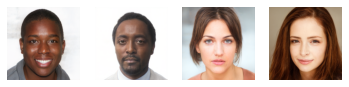

In [4]:
idx = random.sample(range(0, dataset.shape[0]), 4)
with torch.no_grad():
    img = facegen.image_from_w(dataset[idx])
    generator.visual(img)

## Swapping layers

We are going to swap the layers of latent codes in target latent codes (y) into latent codes (x). Here two options are shown, one with consecutive layers ```[5,6,7]``` and sencode one with decrete layers ```[5, 7, 9]```. In the canvas, source faces (x) are shown in the first row, target faces are shown in the second row. The results of swapping layers ```[5,6,7]``` are shown in third row and ones of layers ```[5,7,9]``` are shown in fourth row.

x vs y:  [1.0295904 1.171672  0.974469  0.9897677 1.1249137]
x vs consecutive:  [0.30915517 1.0405297  0.7736448  0.77976084 1.0554364 ]
x vs every others [0.4714716  0.9423537  0.9452512  0.8144261  0.47347686]


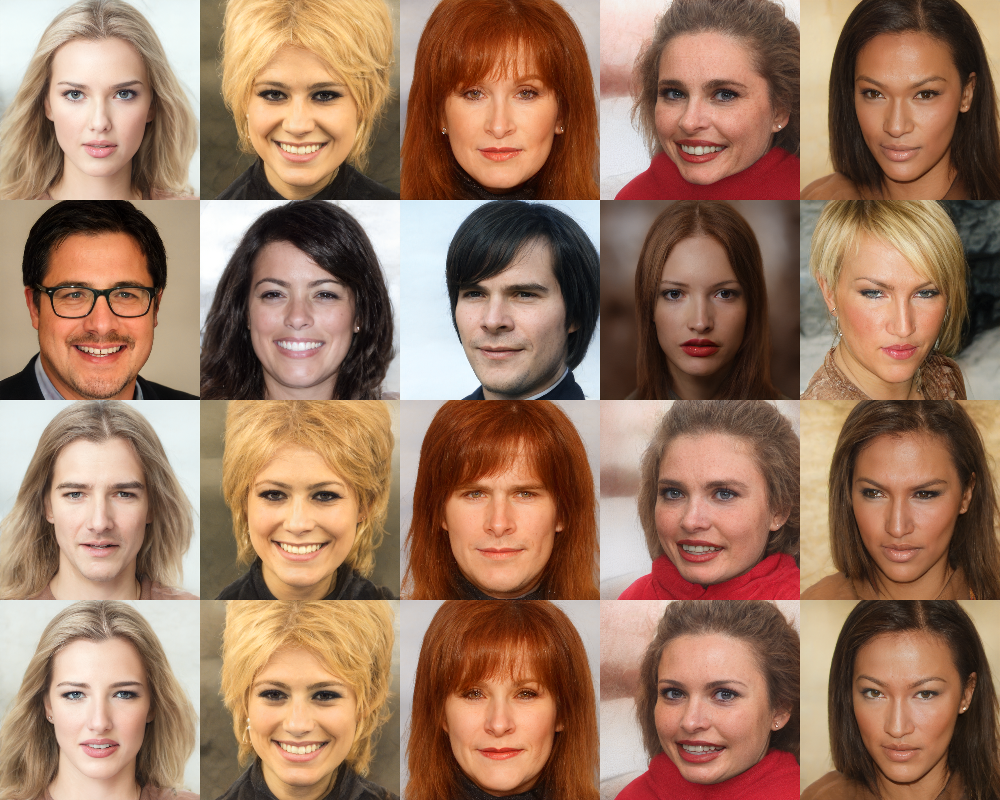

In [5]:
idx_x = random.sample(range(0, dataset.shape[0]), 5)
idx_y = random.sample(range(0, dataset.shape[0]), 5)
with torch.no_grad():
    img_x = facegen.image_from_w(dataset[idx_x])
    img_y = facegen.image_from_w(dataset[idx_y])
    swap_w_00 = generator.swap_w_layers(dataset[idx_x], dataset[idx_y], 
                                         layers = [5,6,7])
    img_swap_00 = facegen.image_from_w(swap_w_00)
    swap_w_01 = generator.swap_w_layers(dataset[idx_x], dataset[idx_y], 
                                         layers = [5, 7, 9])
    img_swap_01 = facegen.image_from_w(swap_w_01)
    print('x vs y: ',facegen.id_dist(img_x, img_y))
    print('x vs consecutive: ',facegen.id_dist(img_x, img_swap_00))
    print('x vs every others', facegen.id_dist(img_x, img_swap_01))
    img_x = [tensor2im(im).resize((512, 512)) for im in img_x]
    img_y = [tensor2im(im).resize((512, 512)) for im in img_y]
    img_swap_00 = [tensor2im(im).resize((512, 512)) for im in img_swap_00]
    img_swap_01 = [tensor2im(im).resize((512, 512)) for im in img_swap_01]
canvas = image_grid(img_x + img_y +img_swap_00 + img_swap_01, 4, 5)
canvas

## Swapping channel-wise

In depth analysis of identity disentanglement (channel-wise) is prepared with the score (rank) of single channel in ```./statistics/channels_rank.npy```. In this experiment we gradually increase the number of top_scores channels from 500 - 2500 to see the effect of the increase on final result.  

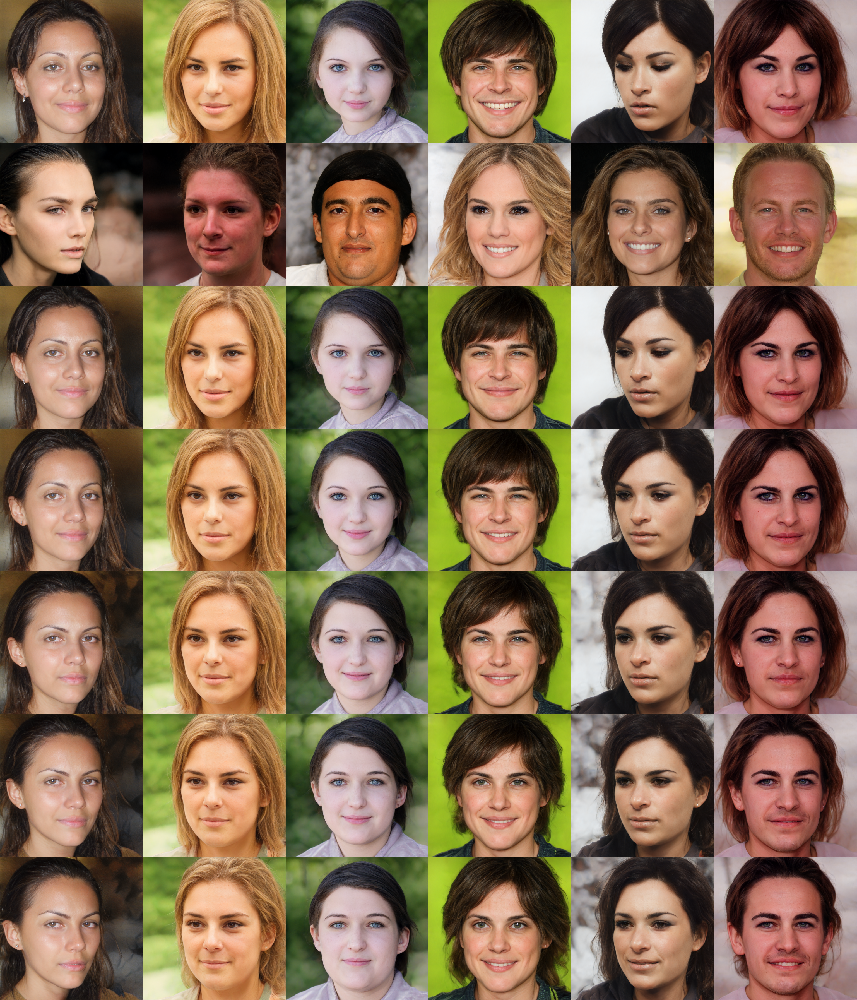

In [6]:
top_scores = np.load('./statistics/channels_rank.npy')

levels = [500, 1000, 1500, 2000, 2500]

idx_x = random.sample(range(0, dataset.shape[0]), 6)
idx_y = random.sample(range(0, dataset.shape[0]), 6)

with torch.no_grad():
    img_x = facegen.image_from_w(dataset[idx_x])
    img_y = facegen.image_from_w(dataset[idx_y])
    img_x = [tensor2im(im).resize((512, 512)) for im in img_x]
    img_y = [tensor2im(im).resize((512, 512)) for im in img_y]

index_swap_images = []
for level in levels:
    top_choices = top_n(top_scores,level)
    index_swap_latent = swap_by_index(top_choices, dataset[idx_x], dataset[idx_y])
    with torch.no_grad():
        index_swap_image = facegen.image_from_w(index_swap_latent)
        index_swap_image = [tensor2im(im).resize((512, 512)) for im in index_swap_image]
        index_swap_images.extend(index_swap_image)

canvas = image_grid(img_x + img_y + index_swap_images, 7, 6)
canvas

## Swap with channels size 256

Similar to the experiment above but with group of 256 channels at once.

In [20]:
top_scores = np.load('./statistics/group_256_rank.npy')

In [30]:
from utils.common import expand_step

In [31]:
top_choices = top_n(top_scores,8)
top_choices

[(6, 0), (6, 1), (5, 0), (4, 0), (4, 1), (5, 1), (9, 0), (8, 1)]

In [32]:
top_choices = expand_step(top_choices,256)

x vs y:  [1.300008  1.3400152 0.6647928 1.1767331 1.0403239 1.0128106]
x vs swap:  [0.8486851  0.9117595  0.36801893 0.92218965 0.627304   0.8428098 ]


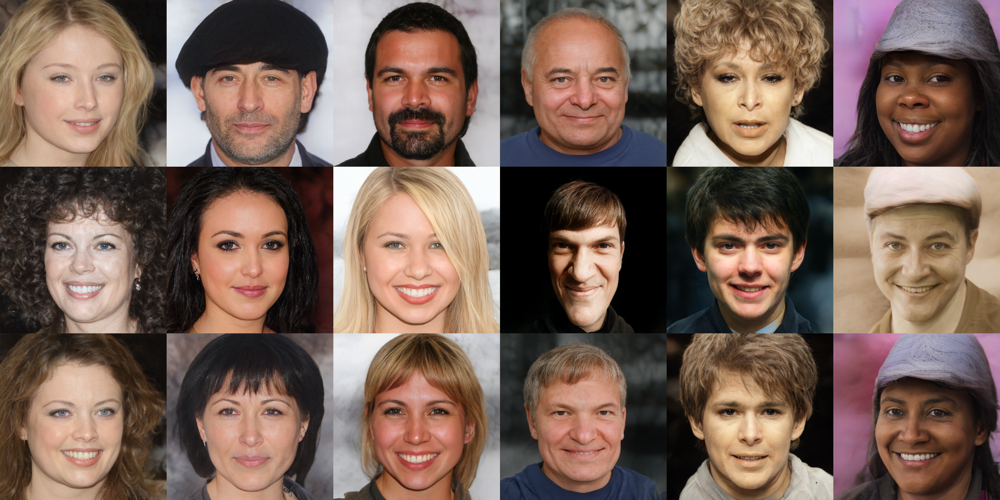

In [33]:

idx_x = random.sample(range(0, dataset.shape[0]), 6)
idx_y = random.sample(range(0, dataset.shape[0]), 6)

index_swap_latent = swap_by_index(top_choices, dataset[idx_x], dataset[idx_y])

with torch.no_grad():
    img_x = facegen.image_from_w(dataset[idx_x])
    img_y = facegen.image_from_w(dataset[idx_y])
    index_swap_image = facegen.image_from_w(index_swap_latent)
    
    print('x vs y: ',facegen.id_dist(img_x, img_y))
    print('x vs swap: ',facegen.id_dist(img_x, index_swap_image))
    img_x = [tensor2im(im).resize((512, 512)) for im in img_x]
    img_y = [tensor2im(im).resize((512, 512)) for im in img_y]
    img_swap_00 = [tensor2im(im).resize((512, 512)) for im in index_swap_image]

canvas = image_grid(img_x + img_y + img_swap_00 , 3, 6)
canvas

## Swap with segmentation mask

Given a facial image, we extract the segmentation mask, from the segmentation mask we generate random face (that shares the mask with original facial image).

x vs y:  [0.88891935 1.0012865  0.85900706 1.0028939 ]


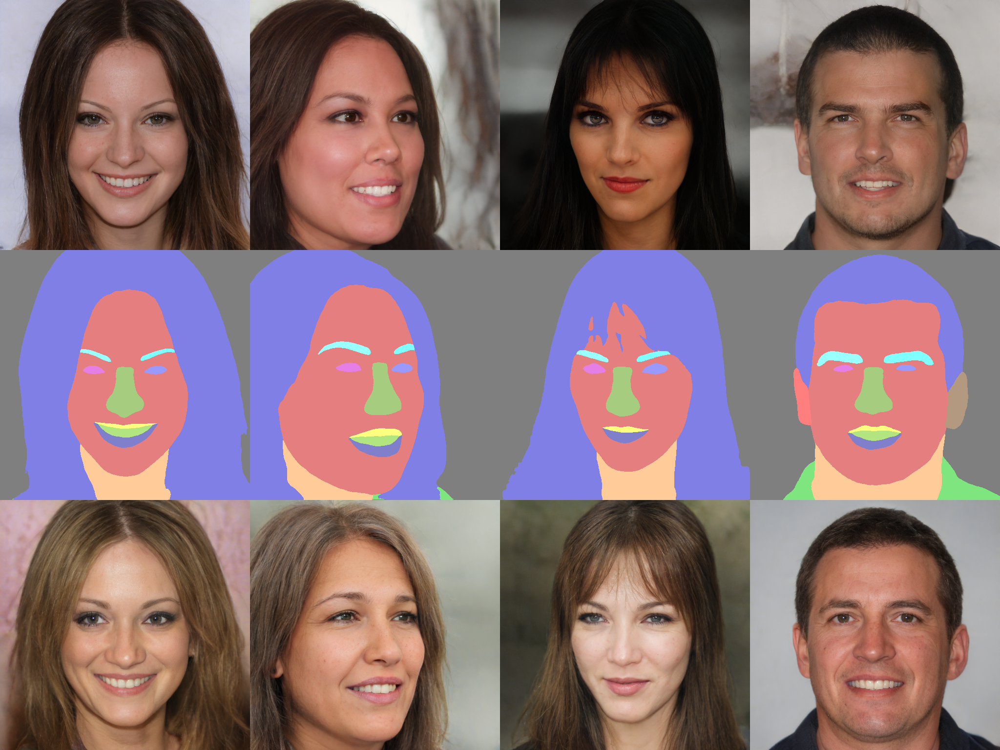

In [13]:

IDX = random.sample(range(0, dataset.shape[0]), 4)
w_current = dataset[IDX].cuda() # (1, 18, 512)

with torch.no_grad():
    n_sample = w_current.shape[0]
    z_vector = torch.randn(n_sample,512)
    #attrs = attrs.repeat(2, 1, 1, 1)
    src_imgs = facegen.image_from_w(w_current)

    plain_mask, color_mask = facegen.get_mask(src_imgs)
    rand_imgs = facegen.rand_face_from_mask(plain_mask, latent_mask = [5,7,9,11])
    print('x vs y: ',facegen.id_dist(src_imgs, rand_imgs))
    
    img_x = [tensor2im(im).resize((512, 512)) for im in src_imgs]
    img_y = [tensor2im(im).resize((512, 512)) for im in rand_imgs]
    img_mask = [tensor2im(im).resize((512, 512)) for im in color_mask]

canvas = image_grid(img_x  +img_mask + img_y, 3, 4)
canvas
   

## The latent mapper

In [25]:
from mapper.styleid_mapper import StyleIDMapper

In [26]:
from argparse import Namespace
ckpt = torch.load("./pretrained_models/mapper.pt", map_location='cpu')
opts = ckpt['opts']
if 'learn_in_w' not in opts:
    opts['learn_in_w'] = False

opts = Namespace(**opts)

net = StyleIDMapper(opts)
net.eval()
net.cuda()

Loading decoder weights from pretrained!


StyleCLIPMapper(
  (mapper): LevelsJoinMapper(
    (medium_mapping): Mapper(
      (mapping): Sequential(
        (0): PixelNorm()
        (1): EqualLinear(1024, 512)
        (2): EqualLinear(512, 512)
      )
    )
  )
  (decoder): Generator(
    (style): Sequential(
      (0): PixelNorm()
      (1): EqualLinear(512, 512)
      (2): EqualLinear(512, 512)
      (3): EqualLinear(512, 512)
      (4): EqualLinear(512, 512)
      (5): EqualLinear(512, 512)
      (6): EqualLinear(512, 512)
      (7): EqualLinear(512, 512)
      (8): EqualLinear(512, 512)
    )
    (input): ConstantInput()
    (conv1): StyledConv(
      (conv): ModulatedConv2d(512, 512, 3, upsample=False, downsample=False)
      (noise): NoiseInjection()
      (activate): FusedLeakyReLU()
    )
    (to_rgb1): ToRGB(
      (conv): ModulatedConv2d(512, 3, 1, upsample=False, downsample=False)
    )
    (convs): ModuleList(
      (0): StyledConv(
        (conv): ModulatedConv2d(512, 512, 3, upsample=True, downsample=False)
     

x vs y:  [1.1223515 0.9708715 1.1467948 1.2167609]
x vs swap:  [1.0714641  0.8328626  0.76570827 0.6428578 ]


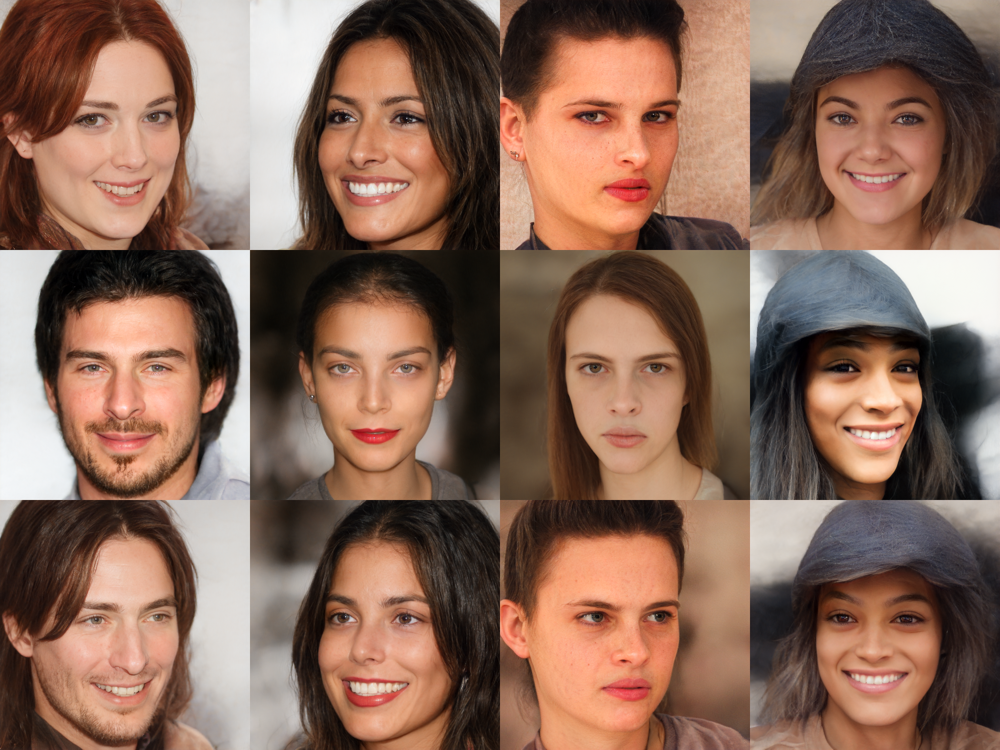

In [28]:
idx_x = random.sample(range(0, dataset.shape[0]), 4)
idx_y = random.sample(range(0, dataset.shape[0]), 4)

with torch.no_grad():
    w_x = dataset[idx_x]
    w_y = dataset[idx_y]
    img_x = facegen.image_from_w(w_x)
    img_y = facegen.image_from_w(w_y)
    

    alpha = net.mapper( w_x.cuda(),w_y.cuda() ).detach().cpu() 

    w_hat = (1 - alpha)* w_x.cpu() + alpha * w_y.cpu()
    swap_image = facegen.image_from_w(w_hat)
    print('x vs y: ',facegen.id_dist(img_x, img_y))
    print('x vs swap: ',facegen.id_dist(img_x, swap_image))
    img_x = [tensor2im(im).resize((512, 512)) for im in img_x]
    img_y = [tensor2im(im).resize((512, 512)) for im in img_y]
    img_swap_00 = [tensor2im(im).resize((512, 512)) for im in swap_image]

canvas = image_grid(img_x + img_y + img_swap_00 , 3, 4)
canvas